Introduction
============

This is interactive notebook regarding "Introduction to path planning". (Author: Björn Hein)

Version | Author
------------ | -------------
0.2 | Björn Hein


License is based on Creative Commons: Attribution-NonCommercial 4.0 International (CC BY-NC 4.0) (pls. check: http://creativecommons.org/licenses/by-nc/4.0/)

This notebook imports all discussed algorithms and does a comparison

Important links are:

* General Info: http://www.python.org
* Python tutorial http://www.python.org/doc/tut/
* NetworkX http://networkx.github.io/
* NumPy and SciPy Guide http://docs.scipy.org/
* Matplotlib gallery http://matplotlib.sourceforge.net/gallery.html


Remember that:

* you have to press ctrl-return or shift-return, to execute the code in the code sections, only then the variables are "generated" and can be used
* you can execute the whole notebook by Cell->runAll

Adding all planners
===========


In [1]:
import matplotlib.pylab as plt
%matplotlib inline
from IPPerfMonitor import IPPerfMonitor
import IPBasicPRM
import IPVISBasicPRM

import IPVisibilityPRM
import IPVISVisibilityPRM

import IPLazyPRM
import IPVISLazyPRM

Set-up of the test scenario and the configuration for all planner
===================================

Following a procedure to compare all discussed planners are shown:

1. Configuration for every planner is defined
2. The configuration and the planner is stored in the variable setup, a Python dict()
3. the variable setup is then used to uniformly call the planning calls


In [2]:
plannerFactory = dict()

basicConfig = dict()
basicConfig["radius"] = 3
basicConfig["numNodes"] = 200
plannerFactory["basePRM"] = [IPBasicPRM.BasicPRM, basicConfig, IPVISBasicPRM.basicPRMVisualize]


basicConfig2 = dict()
basicConfig2["radius"] = 6
basicConfig2["numNodes"] = 600
plannerFactory["basePRM2"] = [IPBasicPRM.BasicPRM, basicConfig2, IPVISBasicPRM.basicPRMVisualize]

basicConfig3 = dict()
basicConfig3["radius"] = 15
basicConfig3["numNodes"] = 300
plannerFactory["basePRM3"] = [IPBasicPRM.BasicPRM, basicConfig3, IPVISBasicPRM.basicPRMVisualize]

visbilityConfig = dict()
visbilityConfig["ntry"] = 300
plannerFactory["visibilityPRM"] = [IPVisibilityPRM.VisPRM, visbilityConfig, IPVISVisibilityPRM.visibilityPRMVisualize ]

lazyConfig = dict()
lazyConfig["initialRoadmapSize"] = 10
lazyConfig["updateRoadmapSize"]  = 5 
lazyConfig["kNearest"] = 8
lazyConfig["maxIterations"] = 20
plannerFactory["lazyPRM"] = [IPLazyPRM.LazyPRM, lazyConfig, IPVISLazyPRM.lazyPRMVisualize]




In [3]:
class ResultCollection (object):
    
    def __init__(self, plannerFactoryName, planner, benchmark, solution, perfDataFrame):
        self.plannerFactoryName = plannerFactoryName
        self.planner = planner
        self.benchmark = benchmark
        self.solution = solution
        self.perfDataFrame = perfDataFrame

In [4]:
import IPTestSuite2D as ts
from shapely.geometry import Point, Polygon, LineString
from shapely import plotting


In [5]:
#import importlib
#importlib.reload(IPTestSuiteSS2024)

In [6]:
fullBenchList = ts.benchList

for benchmark in fullBenchList:
    print(benchmark.name)

Trap
Bottleneck
Fat bottleneck
MyField


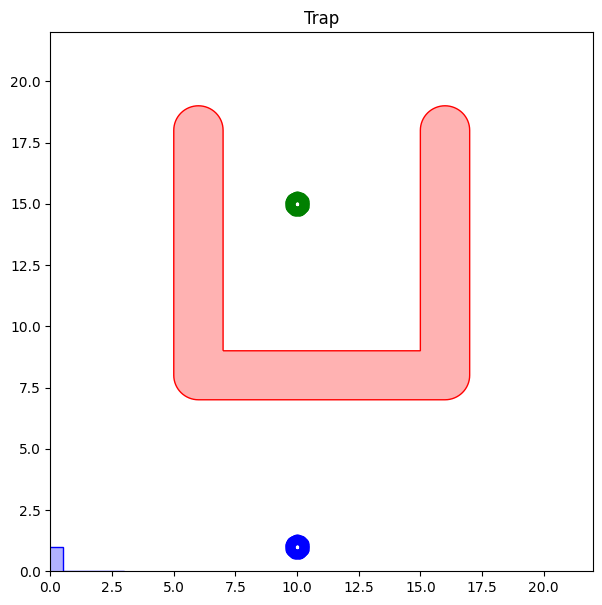

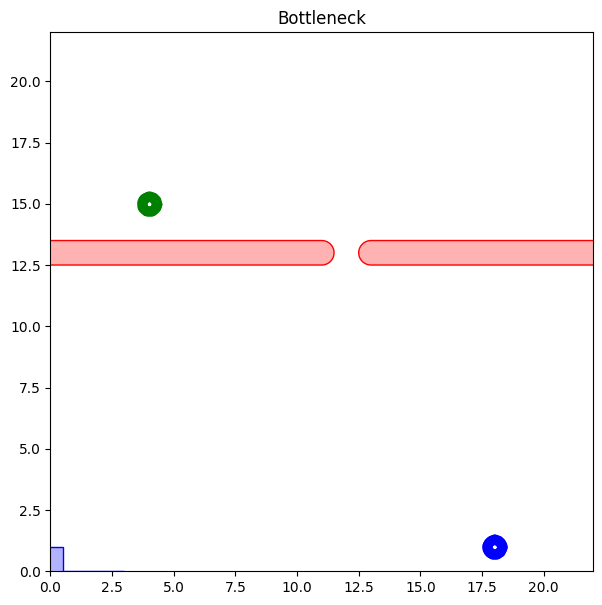

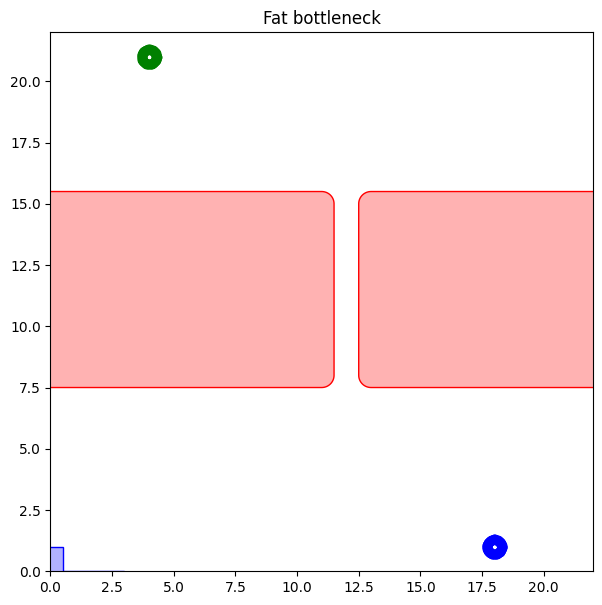

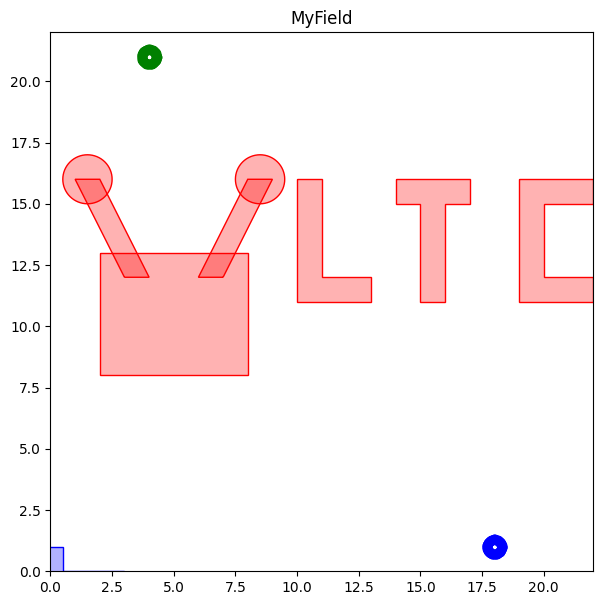

In [7]:
for benchmark in fullBenchList:
    fig_local = plt.figure(figsize=(7,7))
    ax = fig_local.add_subplot(1,1,1)
    title = benchmark.name
    ax.set_title(title)
    ax.set_xlim(benchmark.collisionChecker.getEnvironmentLimits()[0])
    ax.set_ylim(benchmark.collisionChecker.getEnvironmentLimits()[1])
    plotting.plot_points(Point(benchmark.startList[0]).buffer(.3), color="g", ax=ax)
    plotting.plot_points(Point(benchmark.goalList[0]).buffer(.3), color="b", ax=ax)
    #try:
    benchmark.collisionChecker.drawObstacles(ax)
    
        
    #except Exception as e:
    #    print ("Error", e)
    #    pass

    

In [8]:
resultList = list()
testList = fullBenchList

for key,producer in list(plannerFactory.items()):
    print(key, producer)
    for benchmark in testList:
        print ("Planning: " + key + " - " + benchmark.name)
        #planner = IPBasicPRM.BasicPRM(benchmark.collisionChecker)
        planner = producer[0](benchmark.collisionChecker)
        IPPerfMonitor.clearData()
        try:
            
            resultList.append(ResultCollection(key,
                                          planner, 
                                           benchmark, 
                                           planner.planPath(benchmark.startList,benchmark.goalList,producer[1]),
                                           IPPerfMonitor.dataFrame()
                                          ),
                        )
        except Exception as e:
        #    throw e
            print ("PLANNING ERROR ! PLANNING ERROR ! PLANNING ERROR ", e)
            pass
            



basePRM [<class 'IPBasicPRM.BasicPRM'>, {'radius': 3, 'numNodes': 200}, <function basicPRMVisualize at 0x7c07fc2d7e20>]
Planning: basePRM - Trap
Planning: basePRM - Bottleneck
Planning: basePRM - Fat bottleneck
Planning: basePRM - MyField
basePRM2 [<class 'IPBasicPRM.BasicPRM'>, {'radius': 6, 'numNodes': 600}, <function basicPRMVisualize at 0x7c07fc2d7e20>]
Planning: basePRM2 - Trap
Planning: basePRM2 - Bottleneck
Planning: basePRM2 - Fat bottleneck
Planning: basePRM2 - MyField
basePRM3 [<class 'IPBasicPRM.BasicPRM'>, {'radius': 15, 'numNodes': 300}, <function basicPRMVisualize at 0x7c07fc2d7e20>]
Planning: basePRM3 - Trap
Planning: basePRM3 - Bottleneck
Planning: basePRM3 - Fat bottleneck
Planning: basePRM3 - MyField
visibilityPRM [<class 'IPVisibilityPRM.VisPRM'>, {'ntry': 300}, <function visibilityPRMVisualize at 0x7c07fbf14670>]
Planning: visibilityPRM - Trap
Planning: visibilityPRM - Bottleneck
Planning: visibilityPRM - Fat bottleneck
Planning: visibilityPRM - MyField
lazyPRM [<cl

In [ ]:
from IPVISLazyPRM import visibilityPRMVisualizeWspace
import matplotlib.animation
matplotlib.rcParams['animation.embed_limit'] = 256
from IPython.display import HTML, display

import SmoothBG

for result in resultList:
    
    bg_smoother = SmoothBG.SmoothBG()
    configs = {}
    configs["corner_threshold"] = 0.0001
    configs["collision_intervals"] = 30
    configs["max_deltree_depth"] = 20
    # configs["min_deltree_delta"] = 0.0005
    configs["epoches"] = 100


    smoothed_path = bg_smoother.smooth_path(result.solution, result.planner, configs)
    print(result.solution)
    print(smoothed_path)
    G = result.planner.graph
    path = result.solution
    coords = [(G.nodes[n]['pos'][0], G.nodes[n]['pos'][1]) for n in path]
    line = LineString(coords)
    pathLength = line.length
    smoothpath = smoothed_path
    smoothcoords = [(G.nodes[n]['pos'][0], G.nodes[n]['pos'][1]) for n in smoothpath]
    smoothline = LineString(smoothcoords)
    smoothpathLength = smoothline.length
    print(pathLength)
    print(smoothpathLength)
    bg_smoother.visualize_smoothing()
    bg_smoother.animate_path(result.solution, title="Smoothed animation BG")

['start', 40, 90, 68, 75, 112, 56, 9, 22, 4, 165, 113, 80, 20, 44, 15, 83, 146, 46, 43, 70, 24, 30, 35, 69, 149, 92, 1, 72, 143, 164, 34, 134, 3, 'goal']
['start', 'new_start_node_6', 'new_start_node_24', 'new_start_node_94', 'new_goal_node_94', 'new_start_node_62', 'new_goal_node_62', 'new_start_node_40', 'new_goal_node_40', 'new_start_node_16', 'new_start_node_60', 'new_start_node_98', 'new_goal_node_98', 'new_start_node_58', 'new_start_node_100', 'new_goal_node_100', 'new_goal_node_78', 'new_start_node_82', 'new_goal_node_82', 'new_start_node_80', 'new_start_node_84', 'new_goal_node_84', 'new_start_node_32', 'new_start_node_92', 'new_goal_node_92', 'new_start_node_86', 'new_start_node_90', 'new_goal_node_90', 'new_goal_node_88', 'new_goal_node_74', 'new_goal_node_72', 'new_goal_node_68', 'new_goal_node_66', 'new_start_node_64', 'new_start_node_70', 'new_start_node_96', 'new_goal_node_96', 'new_start_node_50', 'new_start_node_106', 'new_goal_node_106', 'new_goal_node_104', 'new_goal_

/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


[]
[]
0.0
0.0
[]
[]
0.0
0.0
[]
[]
0.0
0.0
['start', 1, 17, 30, 43, 158, 14, 46, 2, 21, 75, 15, 18, 7, 9, 4, 'goal']
['start', 'new_start_node_124', 'new_start_node_126', 'new_start_node_128', 'new_start_node_130', 'new_start_node_132', 'new_goal_node_132', 'new_goal_node_90', 'new_goal_node_50', 'new_start_node_120', 'new_goal_node_120', 'new_goal_node_76', 'new_start_node_78', 'new_goal_node_78', 'new_goal_node_56', 'new_goal_node_46', 'new_goal_node_40', 'new_start_node_92', 'new_start_node_114', 'new_start_node_116', 'new_goal_node_116', 'new_start_node_110', 'new_start_node_112', 'new_start_node_122', 'new_goal_node_122', 'new_start_node_102', 'new_start_node_106', 'new_goal_node_106', 'new_start_node_104', 'new_start_node_108', 'new_goal_node_108', 'new_goal_node_96', 'new_start_node_98', 'new_goal_node_98', 'new_start_node_70', 'new_goal_node_70', 'new_start_node_68', 'new_start_node_80', 'new_start_node_82', 'new_start_node_84', 'new_start_node_86', 'new_goal_node_86', 'new_star

/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


[]
[]
0.0
0.0
[]
[]
0.0
0.0
[]
[]
0.0
0.0
['start', 1, 4, 6, 9, 10, 5, 'goal']
['start', 'new_start_node_62', 'new_start_node_64', 'new_start_node_88', 'new_start_node_118', 'new_goal_node_118', 'new_start_node_82', 'new_goal_node_82', 'new_start_node_68', 'new_start_node_114', 'new_start_node_120', 'new_start_node_130', 'new_goal_node_130', 'new_start_node_128', 'new_start_node_132', 'new_goal_node_132', 'new_start_node_134', 'new_goal_node_134', 'new_goal_node_108', 'new_goal_node_56', 'new_start_node_110', 'new_goal_node_110', 'new_start_node_112', 'new_goal_node_112', 'new_start_node_60', 'new_start_node_76', 'new_start_node_84', 'new_goal_node_84', 'new_start_node_126', 'new_goal_node_126', 'new_goal_node_96', 'new_goal_node_94', 'new_goal_node_92', 'new_goal_node_90', 'new_start_node_74', 'new_start_node_80', 'new_start_node_98', 'new_start_node_116', 'new_start_node_122', 'new_start_node_124', 'new_goal_node_124', 'new_goal_node_106', 'new_goal_node_104', 'goal']
54.795422462432

/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


[]
[]
0.0
0.0
[]
[]
0.0
0.0
[]
[]
0.0
0.0
['start', 87, 92, 18, 21, 1, 49, 46, 'goal']
['start', 'new_start_node_64', 'new_goal_node_64', 'new_start_node_56', 'new_start_node_58', 'new_start_node_60', 'new_start_node_106', 'new_start_node_108', 'new_goal_node_108', 'new_start_node_132', 'new_goal_node_132', 'new_goal_node_130', 'new_goal_node_110', 'new_goal_node_94', 'new_goal_node_92', 'new_start_node_90', 'new_start_node_116', 'new_goal_node_116', 'new_start_node_52', 'new_start_node_68', 'new_start_node_74', 'new_start_node_80', 'new_start_node_124', 'new_goal_node_124', 'new_goal_node_120', 'new_start_node_126', 'new_goal_node_126', 'new_goal_node_122', 'new_goal_node_96', 'new_start_node_84', 'new_goal_node_84', 'new_start_node_86', 'new_start_node_88', 'new_goal_node_88', 'new_start_node_104', 'new_goal_node_104', 'new_start_node_102', 'new_start_node_114', 'new_goal_node_114', 'new_start_node_112', 'new_goal_node_112', 'new_goal_node_98', 'goal']
68.0812356291776
31.67040511754

/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


/home/benjamin/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)
Error 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)


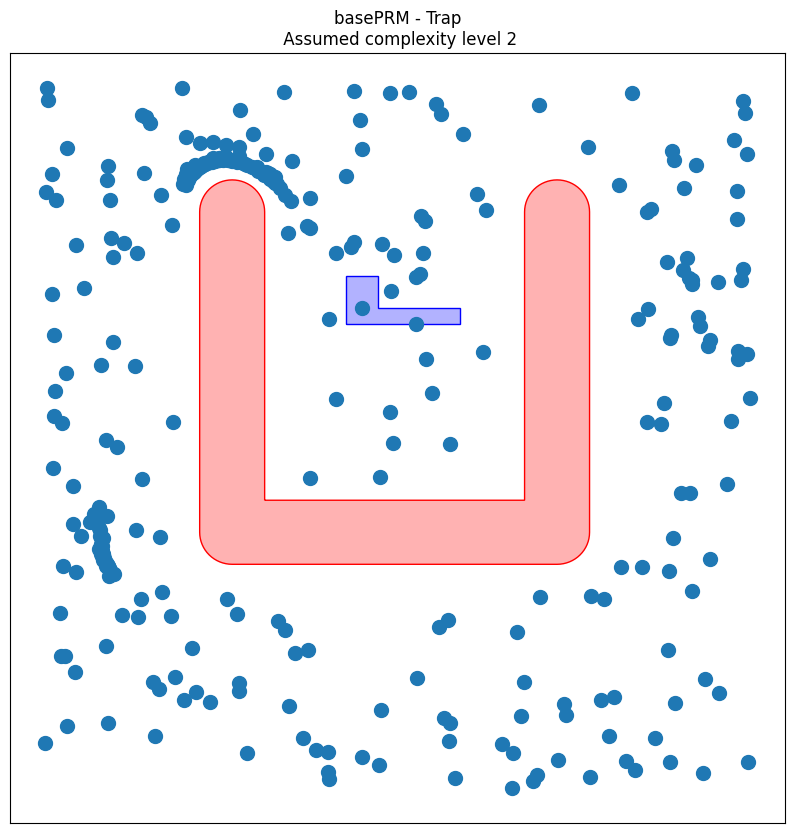

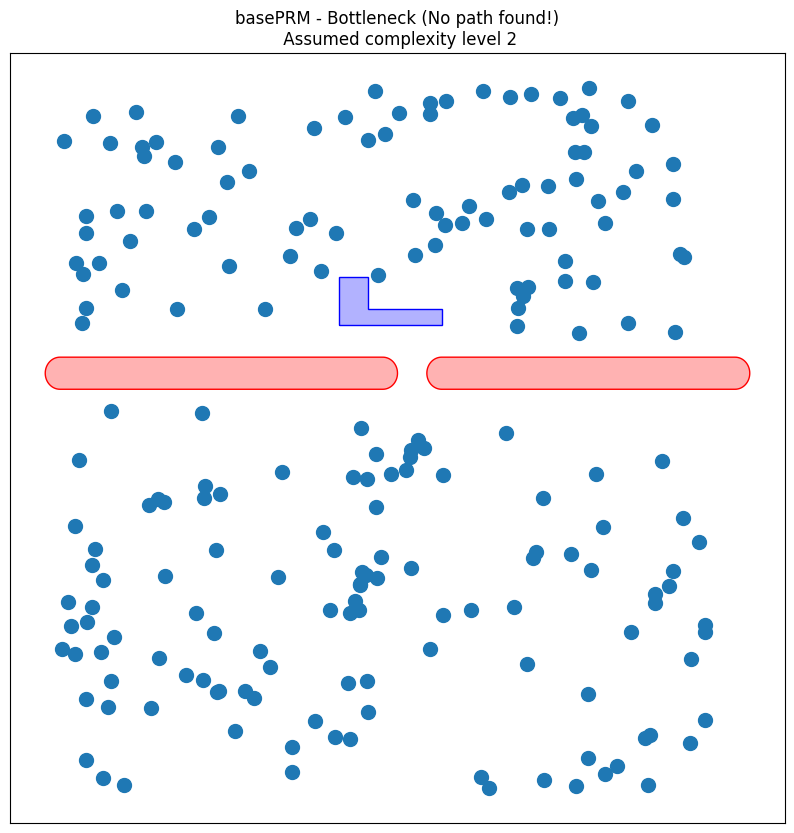

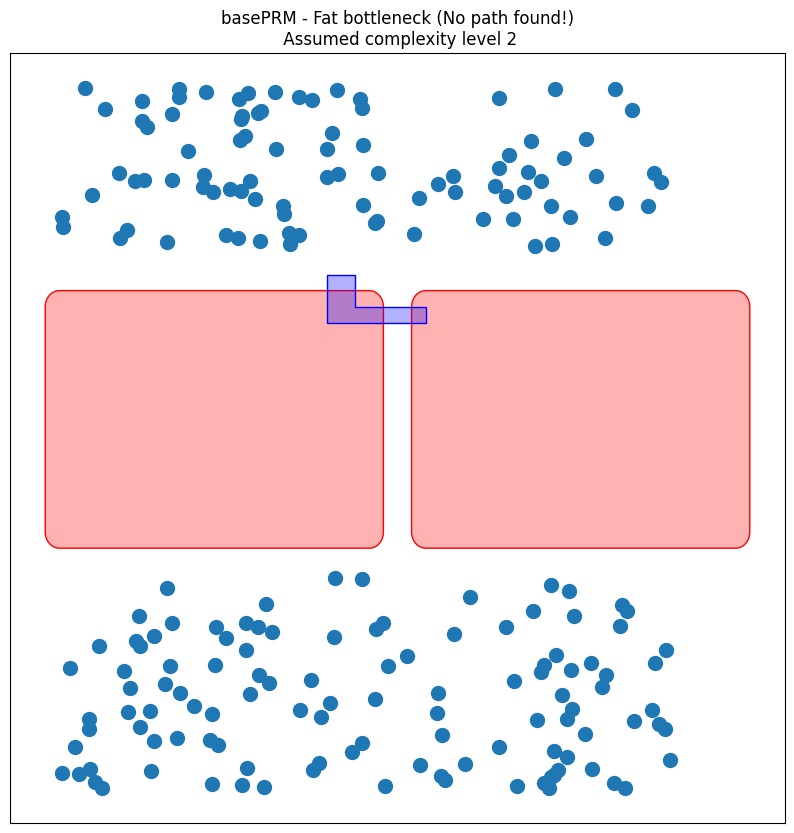

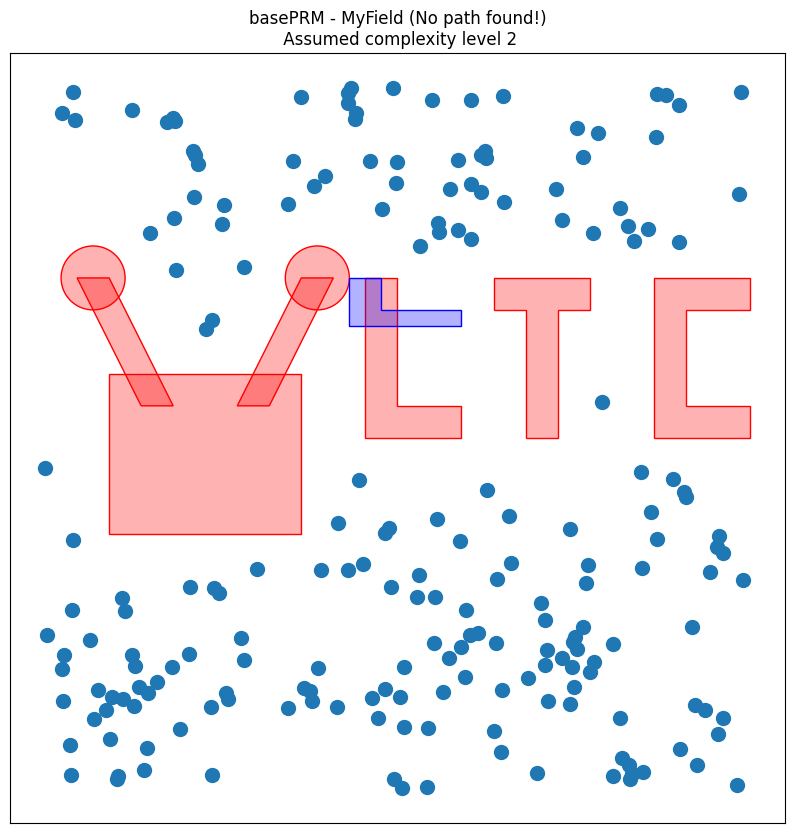

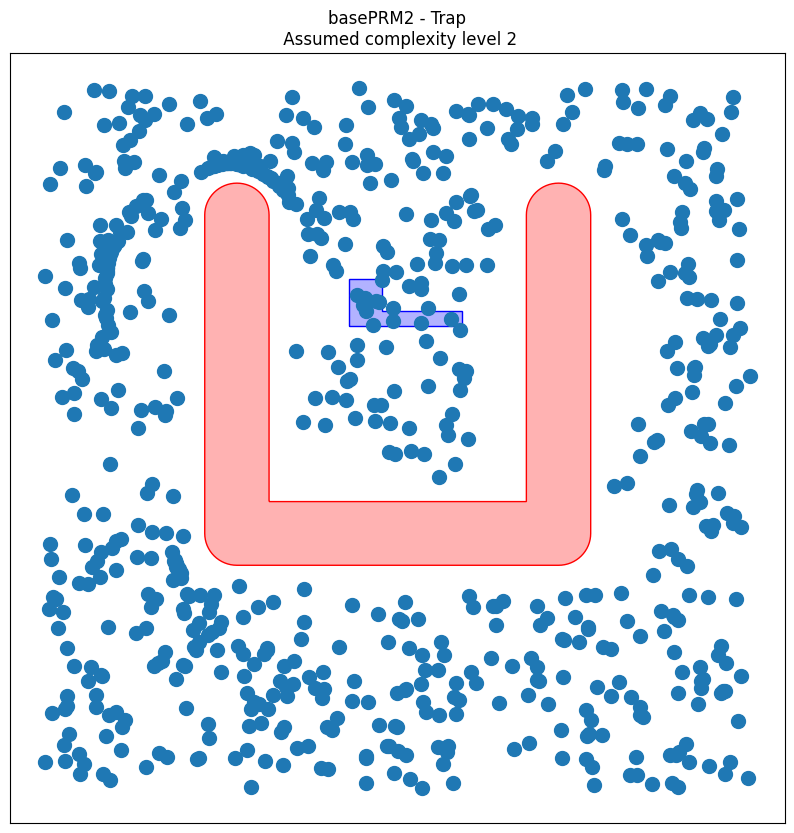

...

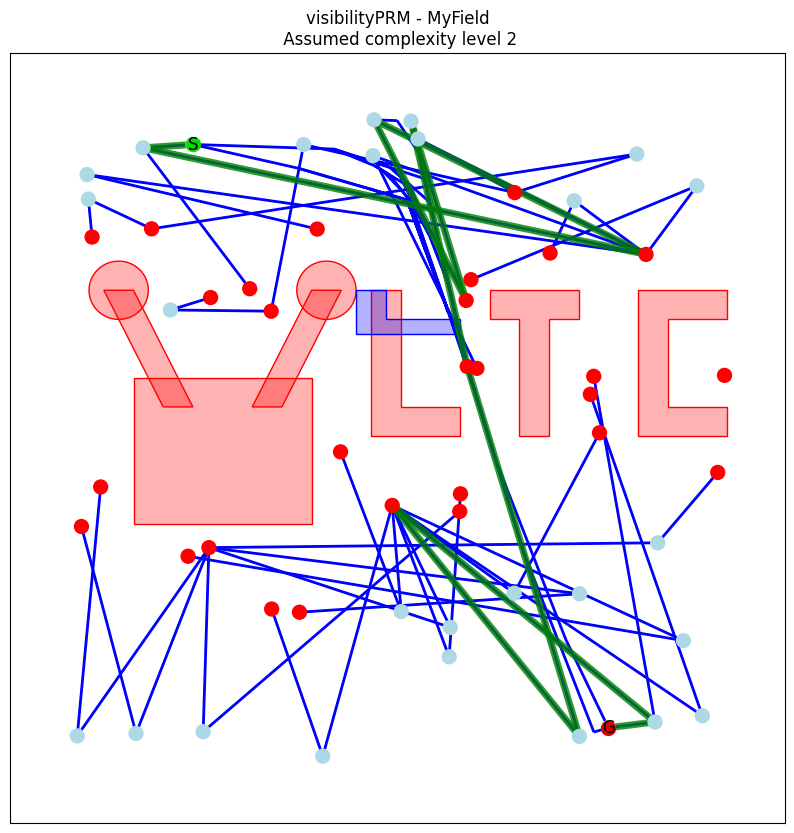

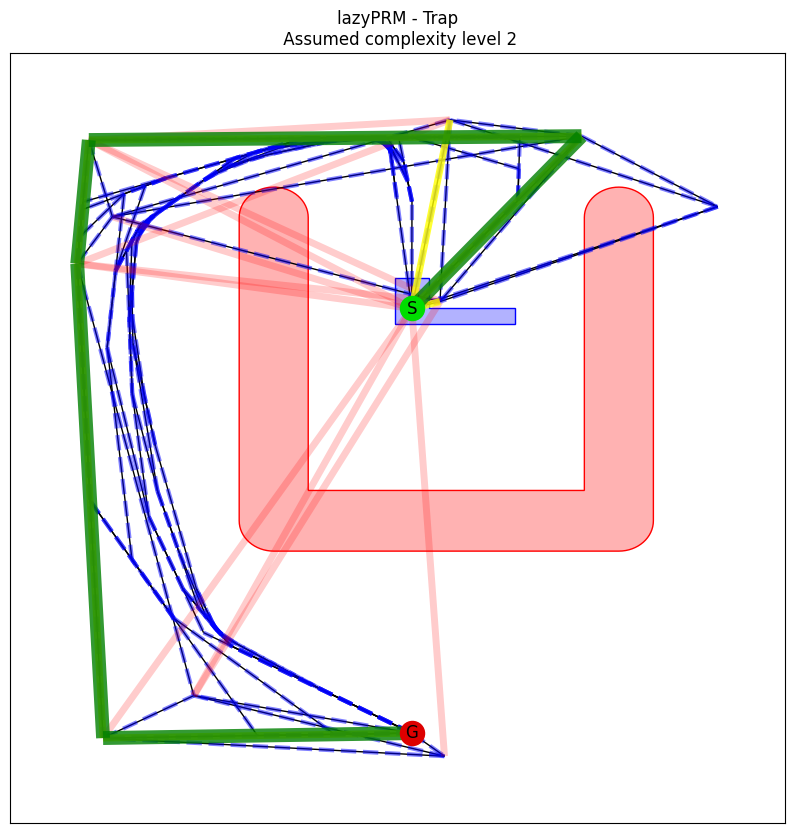

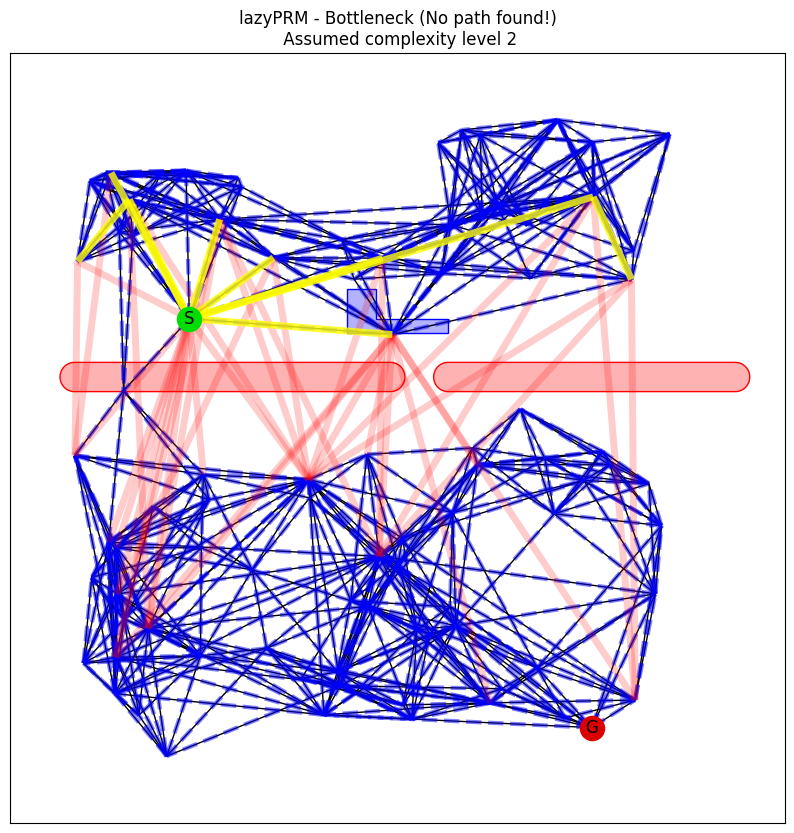

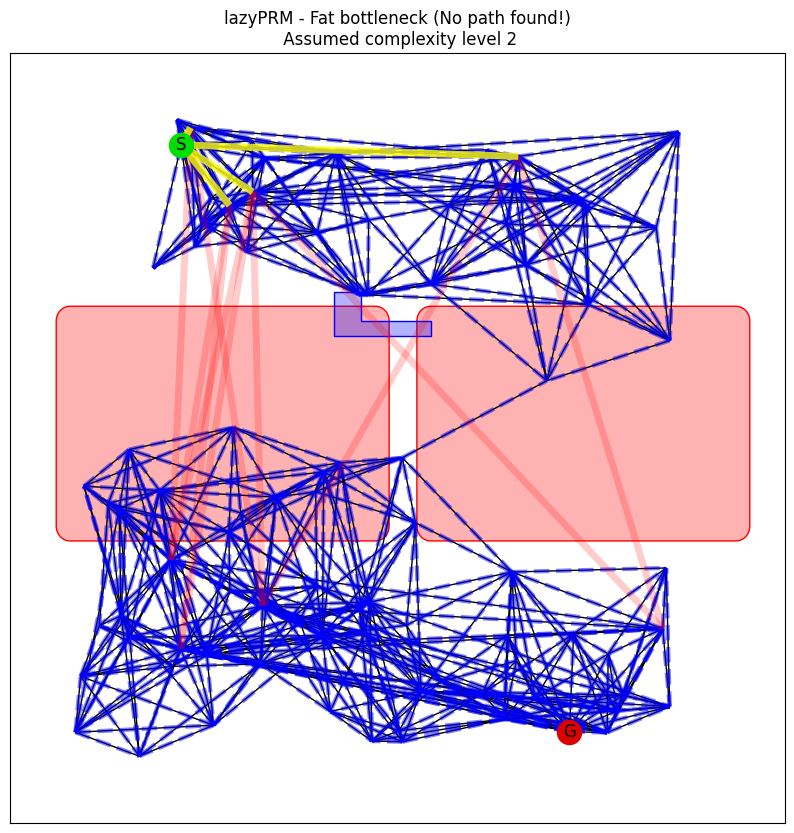

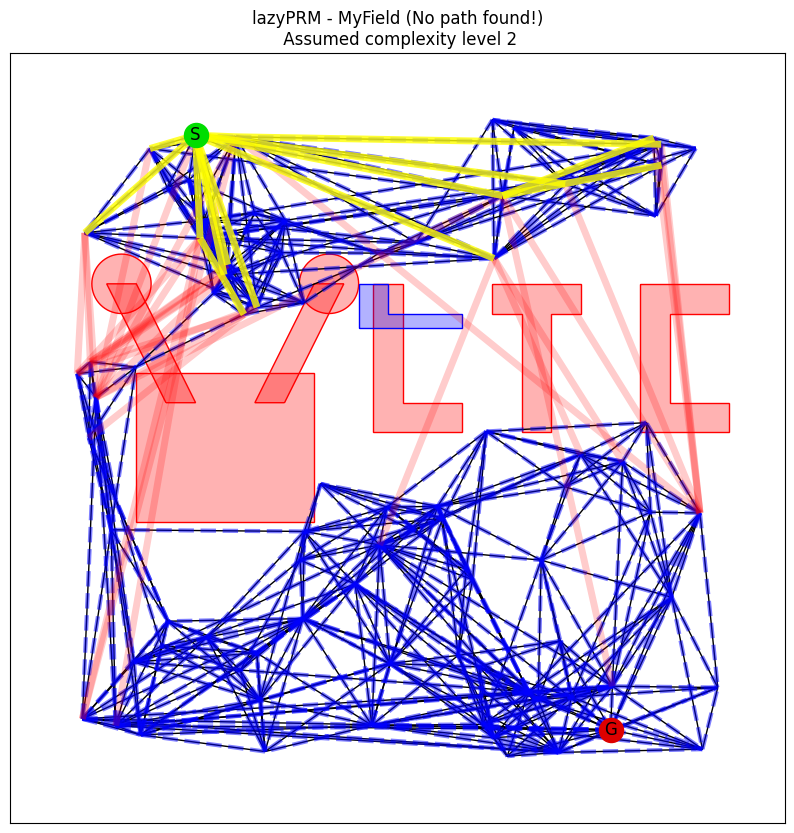

In [ ]:
import matplotlib.pyplot as plt

for result in resultList:
    
    fig_local = plt.figure(figsize=(10,10))
    ax = fig_local.add_subplot(1,1,1)
    title = result.plannerFactoryName + " - " + result.benchmark.name
    if result.solution == []:
        title += " (No path found!)"
    title += "\n Assumed complexity level " + str(result.benchmark.level)
    ax.set_title(title)
    try:
        #IPVISBasicsPRM.basicPRMVisualize(result.planner, result.solution, ax=ax, nodeSize=100))
        plannerFactory[result.plannerFactoryName][2](result.planner, result.solution, ax=ax, nodeSize=100)
    except Exception as e:
        print ("Error", e)
        pass
    

In [ ]:
import numpy as np
for bench in testList:
    title = bench.name
    pathLength = dict()
    planningTime = dict()
    roadmapSize  = dict()
    smoothpathLength  = dict()
    
    try:
        for result in resultList:
            if result.benchmark.name == bench.name:
                #print result.benchmark.name  + " - " +  result.plannerFactoryName, len(result.solution)
                G = result.planner.graph
                path = result.solution
                coords = [(G.nodes[n]['pos'][0], G.nodes[n]['pos'][1]) for n in path]
                line = LineString(coords)
                pathLength[result.plannerFactoryName] = line.length
                smoothpath = result.smoothsolution
                smoothcoords = [(G.nodes[n]['pos'][0], G.nodes[n]['pos'][1]) for n in smoothpath]
                smoothline = LineString(smoothcoords)
                smoothpathLength[result.plannerFactoryName] = smoothline.length
                planningTime[result.plannerFactoryName] = result.perfDataFrame.groupby(["name"]).sum(numeric_only=True)["time"]["planPath"]
                roadmapSize[result.plannerFactoryName] = result.planner.graph.size()

        fig, ax = plt.subplots()

        labels = list(pathLength.keys())
        x = np.arange(len(labels))
        width = 0.2

        # 1) Path length
        ax.bar(x - 1.5*width, pathLength.values(), width, color="blue")
        ax.set_ylabel(title + " Length of planned path", color="blue")

        # 2) Planning time
        ax2 = ax.twinx()
        bars2 = ax2.bar(x - 0.5*width, planningTime.values(), width, color="red")
        ax2.set_ylabel(title + " Planning time", color="red")

        # Coloring / hatching for planning time
        hatches = ['x' if length == 0 else '' for length in pathLength.values()]
        colors  = ['red' if length == 0 else 'yellow' for length in pathLength.values()]
        for i, b in enumerate(bars2):
            b.set_facecolor(colors[i])
            b.set_hatch(hatches[i])

        # 3) Roadmap size
        ax3 = ax.twinx()
        ax3.bar(x + 0.5*width, roadmapSize.values(), width, color="purple")
        ax3.set_ylabel(title + " Roadmap size", color="purple")
        ax3.spines['right'].set_position(('axes', 1.15))
        ax3.spines['right'].set_color("purple")

        # 4) Path length after smoothing
        ax4 = ax.twinx()
        ax4.bar(x + 1.5*width, smoothpathLength.values(), width, color="green")
        ax4.set_ylabel(title + " Length of path after smoothing", color="green")
        ax4.spines['right'].set_position(('axes', 1.30))
        ax4.spines['right'].set_color("green")

        # X-Achse
        ax.set_xticks(x)
        ax.set_xticklabels(labels)
    except:
        pass


    
        
    